In [1]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

In [2]:
img = cv2.imread('1.jpg')
cv2.imshow('sea view' , img)
cv2.waitKey(0)
cv2.destroyAllWindows()


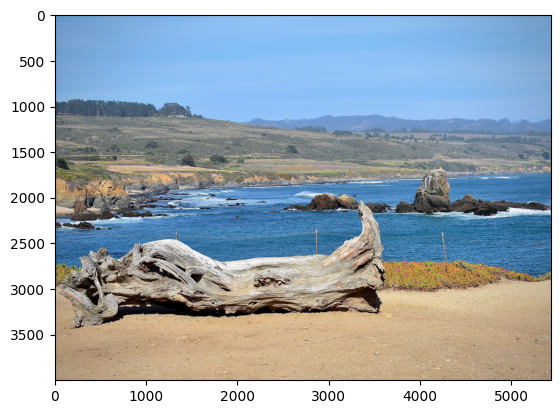

In [3]:

plt.imshow(cv2.cvtColor(img , cv2.COLOR_BGR2RGB))
plt.show()

In [4]:
cv2.imwrite('view.jpg',img) # save image 

True

In [5]:
cap = cv2.VideoCapture(0)
while cap.isOpened():
    ret ,frame = cap.read()
    if not ret : 
        break
    gray = cv2.cvtColor(frame , cv2.COLOR_BGR2GRAY)
    cv2.imshow('original',frame)
    cv2.imshow("gray" , gray)
    if cv2.waitKey(10) &0XFF ==ord('q'):
        break
cap.release()
cv2.destroyAllWindows()        

In [6]:
img=cv2.imread('1.jpg',0)
cv2.imshow('img',img)
cv2.waitKey(0)
cv2.destroyAllWindows()

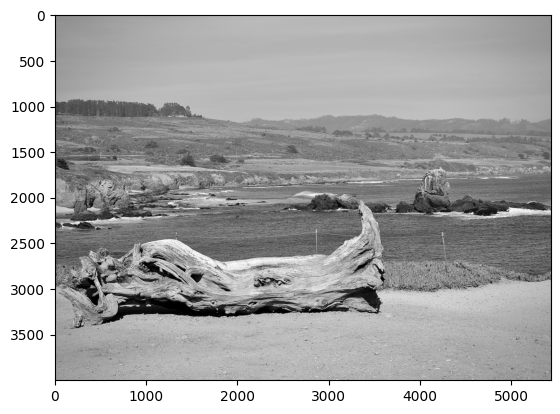

In [7]:
plt.imshow(img,'gray')
plt.show()

In [8]:
img=cv2.imread('1.jpg',1)
cv2.imshow('img',img)
cv2.waitKey(0)
cv2.destroyAllWindows()

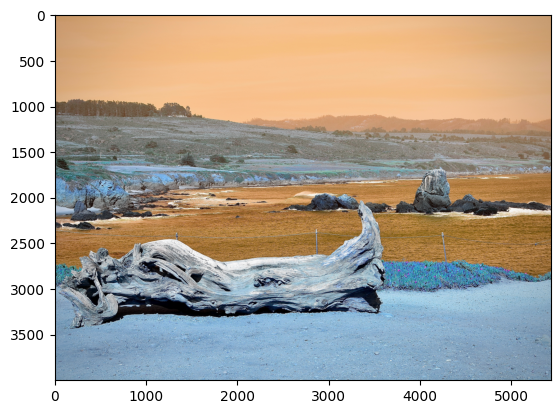

In [9]:
plt.imshow(img)
plt.show()

In [10]:
img.shape

(4000, 5436, 3)

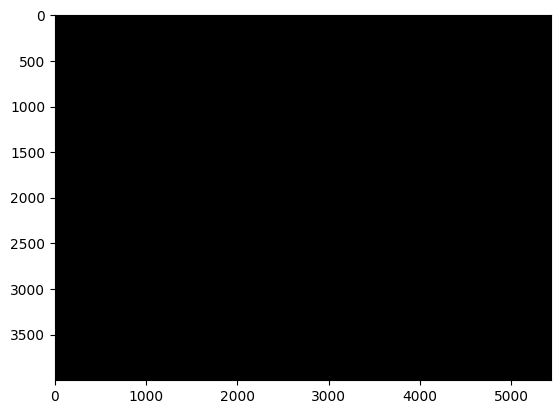

In [11]:
plt.imshow(np.zeros_like(img))
plt.show()

In [12]:
a=np.uint8([150])
b=np.uint8([200])
print(cv2.add(a,b))
print(cv2.subtract(a,b))

[[255]]
[[0]]


In [13]:
import cv2
import numpy as np
import matplotlib.pyplot as plt
cap=cv2.VideoCapture(0)
while cap.isOpened():
    ret,frame=cap.read()
    if not ret :
        break
    hsv= cv2.cvtColor(frame ,cv2.COLOR_BGR2HSV)
    lower_limit = np.array([70,70,70])
    upper_limit =np.array([130,255,255])
    mask= cv2.inRange(hsv,lower_limit,upper_limit)
    res = cv2.bitwise_and(frame,frame,mask=mask)
    cv2.imshow('mask',mask)
    cv2.imshow('original' , frame)
    cv2.imshow('result',res)
    if cv2.waitKey(10)& 0XFF == ord('q'):
        break
cap.release()
cv2.destroyAllWindows()        

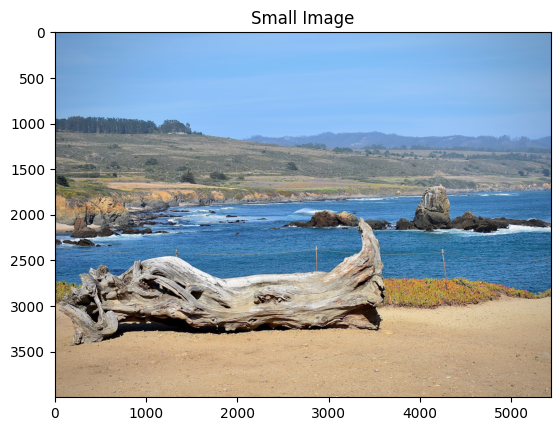

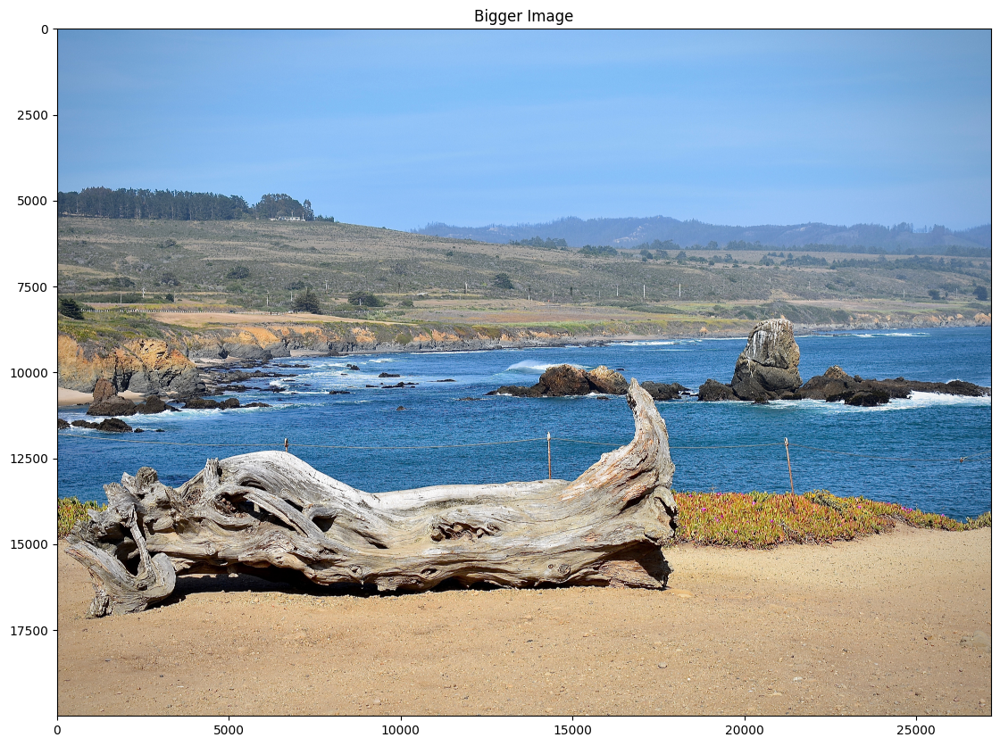

In [14]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('1.jpg')
img = cv2.cvtColor(img ,cv2.COLOR_BGR2RGB)

height , width = img.shape[0],img.shape[1]

resized_img = cv2.resize(img ,(width*5 , height*5) ,interpolation = cv2.INTER_LINEAR )

# Display the first image
plt.imshow(img)
plt.title('Small Image')
plt.show()

# Display the second image
plt.figure(figsize=(16, 10))
plt.imshow(resized_img)
plt.title('Bigger Image')
plt.show()

## Geometric Transformation

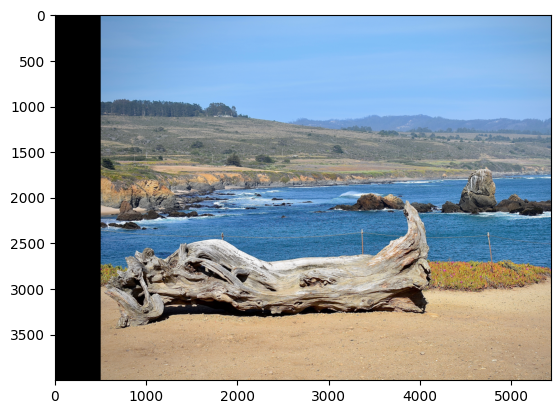

In [15]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

height , width = img.shape[0] , img.shape[1]

# Translation 
M = np.float32([[1,0,500],
                [0,1,0]])
dst = cv2.warpAffine(img,M,(width,height))
plt.imshow(dst)
plt.show()

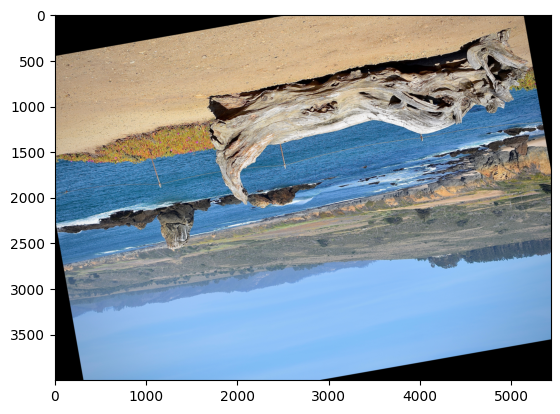

In [16]:
M =cv2.getRotationMatrix2D((width/2,height/2),190,1)

dst2 = cv2.warpAffine(img,M,(width,height))
plt.imshow(dst2)
plt.show()

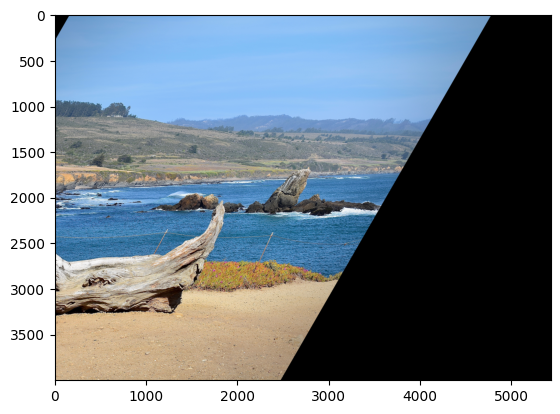

In [17]:
pts1 = np.float32([[10,100],[200,50],[100,250]])
pts2 = np.float32([[110,100],[300,50],[100,250]])

M = cv2.getAffineTransform(pts1,pts2)

dst=cv2.warpAffine(img,M,(width,height))
plt.imshow(dst)
plt.show()

## Image Filtering

In [18]:
# Box filter
# Gaussian filter
# Median filter

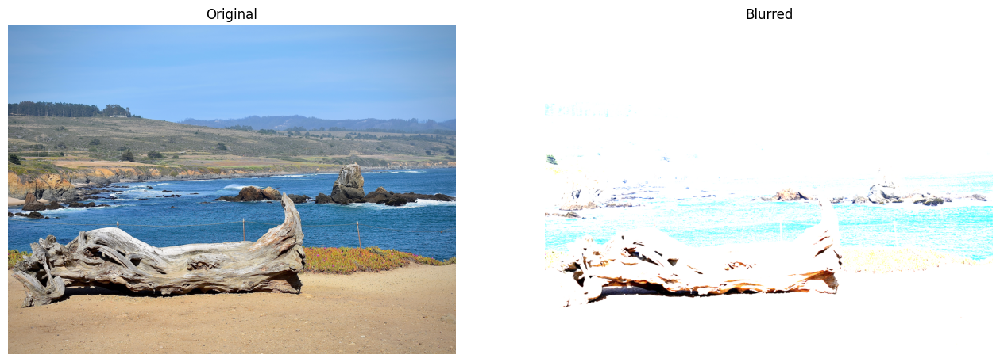

In [19]:
import cv2
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('1.jpg')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

kernel = np.ones((10,10),np.float32)/25
dst = cv2.filter2D(src= img , ddepth=-1,kernel=kernel)

# Create a new figure
plt.figure(figsize=(16, 10))

# Display the first image
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 2, 2)
plt.imshow(dst)
plt.axis('off')
plt.title('Blurred')

plt.show()

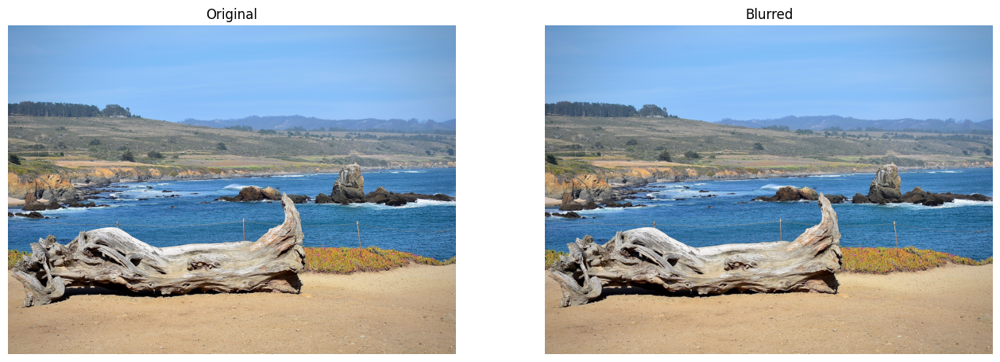

In [20]:
dst = cv2.blur(img ,(5,5))

# Create a new figure
plt.figure(figsize=(16, 10))

# Display the first image
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 2, 2)
plt.imshow(dst)
plt.axis('off')
plt.title('Blurred')

plt.show()

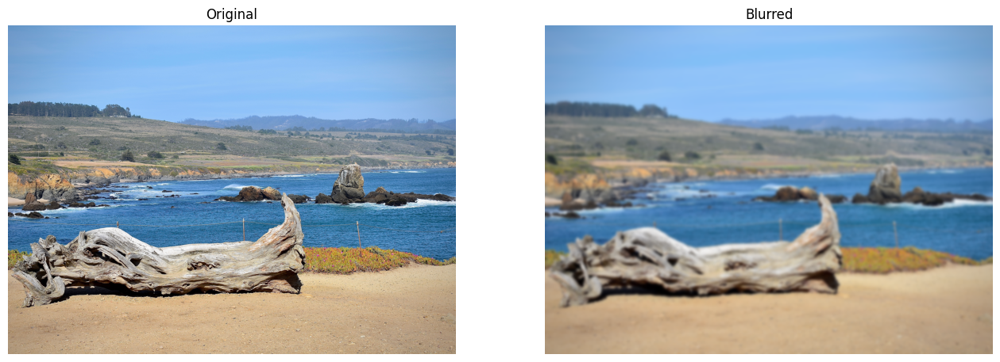

In [21]:
dst = cv2.GaussianBlur(img, (101, 101), 0)

# Create a new figure
plt.figure(figsize=(16, 10))

# Display the first image
plt.subplot(1, 2, 1)
plt.imshow(img)
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 2, 2)
plt.imshow(dst)
plt.axis('off')
plt.title('Blurred')

plt.show()

# Image Thresholding 

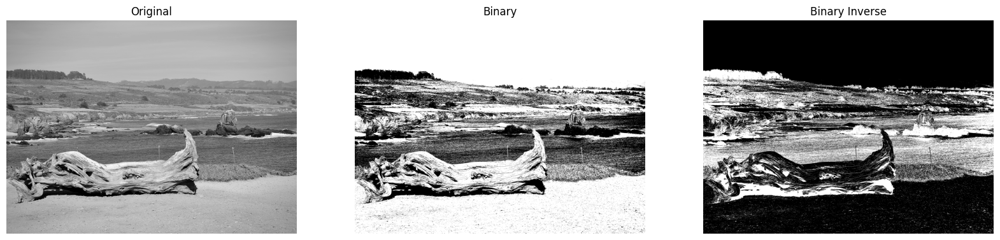

In [18]:
import numpy as np 
import cv2 
import matplotlib.pyplot as plt 

img = cv2.imread('1.jpg',0)
#img = cv2.cvtColor(img , cv2.COLOR_BGR2RGB)

ret , thresloding = cv2.threshold(img , 127,255 ,cv2.THRESH_BINARY)
ret , thresloding2 = cv2.threshold(img , 127,255 ,cv2.THRESH_BINARY_INV)

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the first image
plt.subplot(1, 3, 1)
plt.imshow(img,cmap='gray')
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 3, 2)
plt.imshow(thresloding,cmap='gray')
plt.axis('off')
plt.title('Binary')

# Display the second image
plt.subplot(1, 3, 3)
plt.imshow(thresloding2,cmap='gray')
plt.axis('off')
plt.title('Binary Inverse')

plt.show()


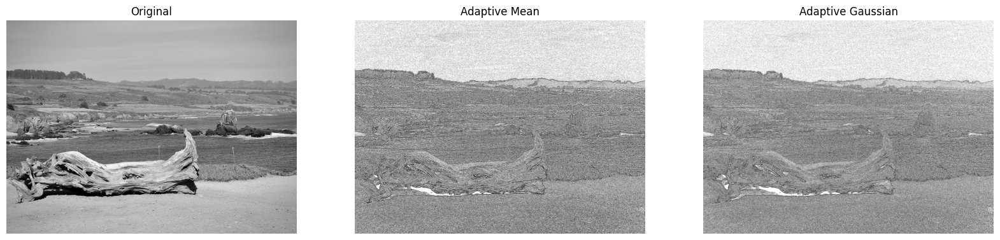

In [20]:
# Adaptive Threshold 

thresloding_1 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_MEAN_C, cv2.THRESH_BINARY, 11, 2)
thresloding_2 = cv2.adaptiveThreshold(img, 255, cv2.ADAPTIVE_THRESH_GAUSSIAN_C, cv2.THRESH_BINARY, 11, 2)

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the first image
plt.subplot(1, 3, 1)
plt.imshow(img,cmap='gray')
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 3, 2)
plt.imshow(thresloding_1,cmap='gray')
plt.axis('off')
plt.title('Adaptive Mean')

# Display the second image
plt.subplot(1, 3, 3)
plt.imshow(thresloding_2,cmap='gray')
plt.axis('off')
plt.title('Adaptive Gaussian')

plt.show()

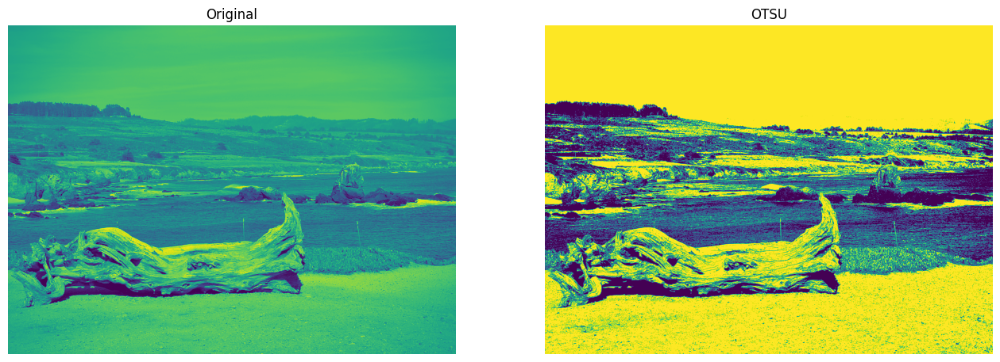

In [24]:
ret , thresloding = cv2.threshold(img , 0 ,255 , cv2.THRESH_BINARY+cv2.THRESH_OTSU)

# Create a new figure
plt.figure(figsize=(16, 10))

# Display the first image
plt.subplot(1, 2, 1)
plt.imshow(img,cmap='gray')
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 2, 2)
plt.imshow(thresloding,cmap='gray')
plt.axis('off')
plt.title('OTSU')

plt.show()

# Morphological Transformation

* Erosion 
* Dilation

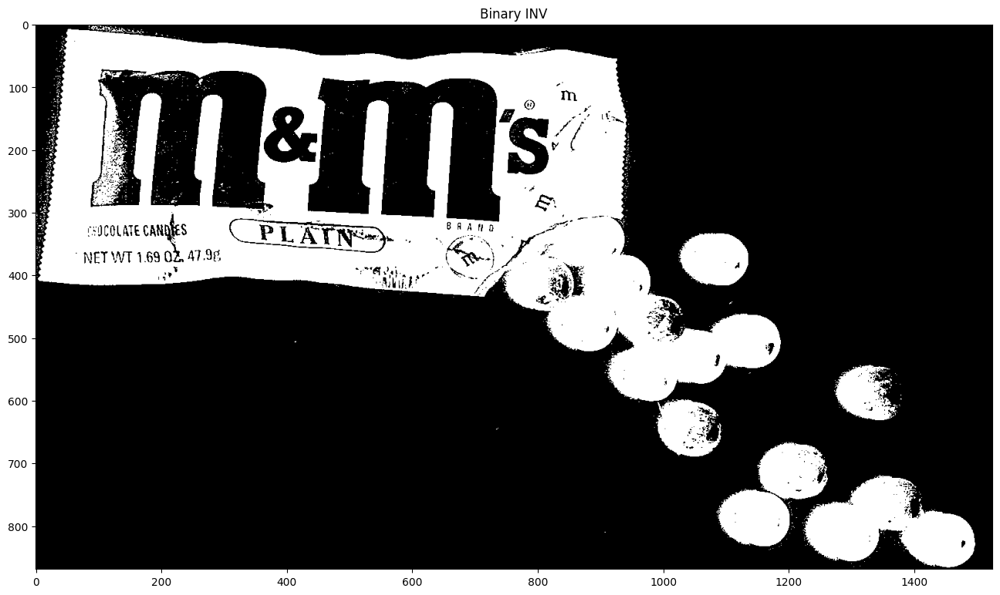

In [21]:
import cv2
import numpy as np 
import matplotlib.pyplot as plt

img = cv2.imread('2.png' ,0)
# img = cv2.cvtColor(img ,cv2.COLOR_BGR2RGB)
ret , thresloding = cv2.threshold(img ,180 , 255, cv2.THRESH_BINARY_INV)

plt.figure(figsize=(16,10))
plt.imshow(thresloding,cmap='gray')
plt.title('Binary INV')
plt.show()

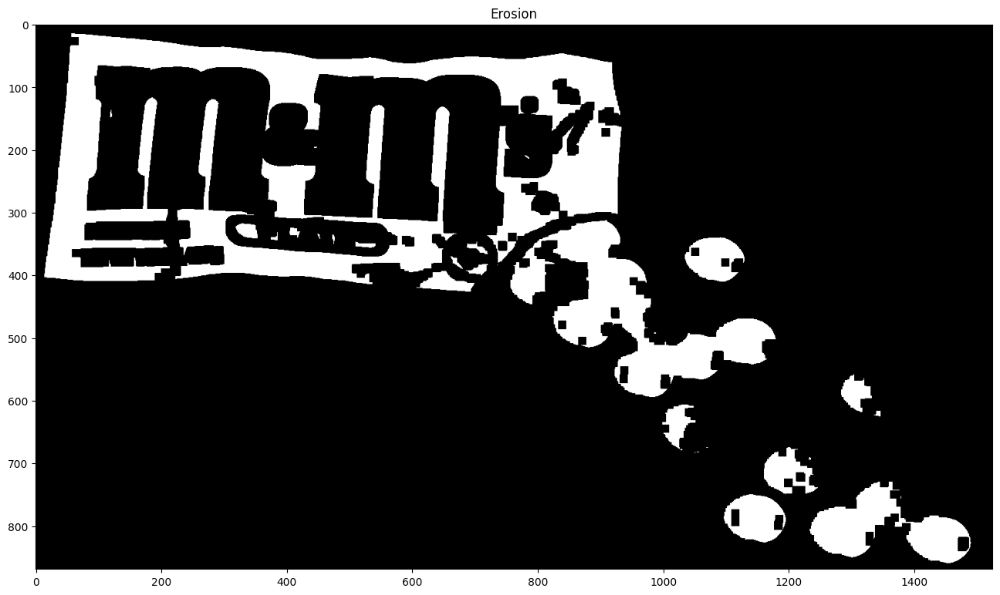

In [24]:
# Erosion 
kernal = np.ones((5,5))
erosion = cv2.erode(thresloding , kernel=kernal , iterations=3)

plt.figure(figsize=(16,10))
plt.imshow(erosion,cmap='gray')
plt.title('Erosion')
plt.show()

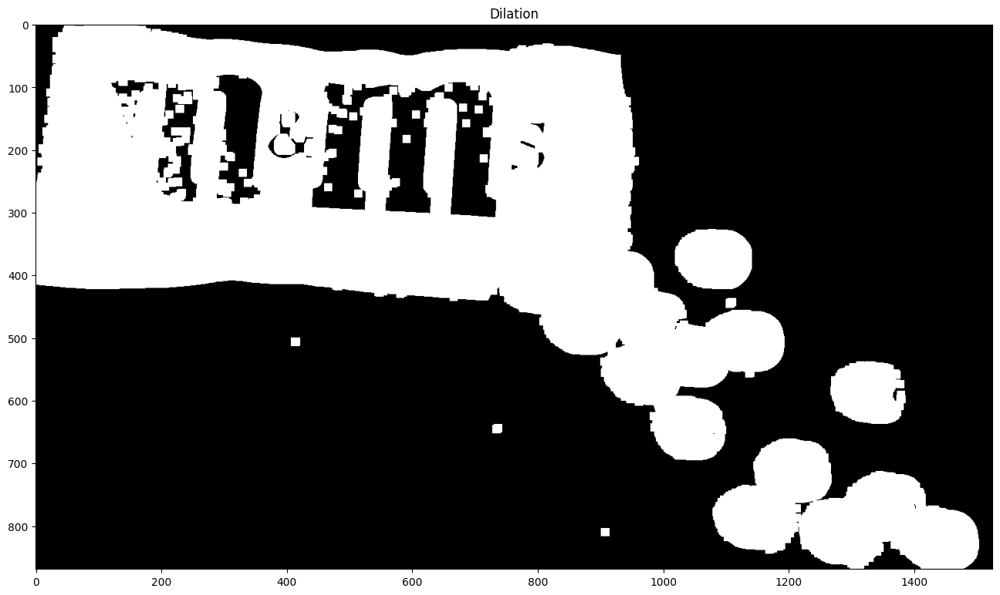

In [26]:
# Dilation  
kernal = np.ones((5,5))
dilation = cv2.dilate(thresloding , kernel=kernal , iterations=3)

plt.figure(figsize=(16,10))
plt.imshow(dilation,cmap='gray')
plt.title('Dilation')
plt.show()

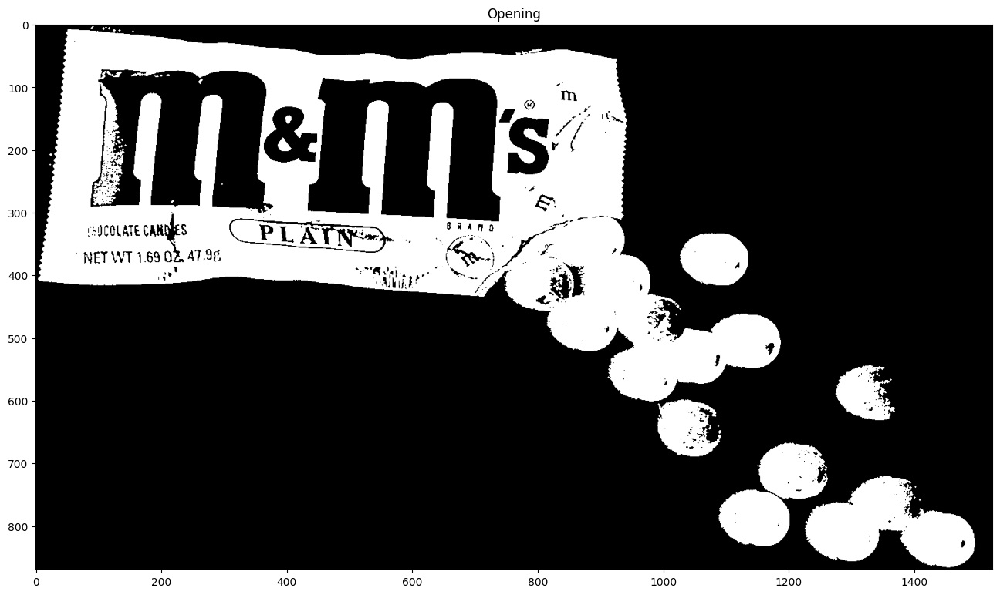

In [27]:
# Opening
kernal = np.uint8([[0,1,0],
                  [1,1,1],
                  [0,1,0]])
opening = cv2.morphologyEx(thresloding , cv2.MORPH_OPEN , kernel=kernal)

plt.figure(figsize=(16,10))
plt.imshow(opening,cmap='gray')
plt.title('Opening')
plt.show()


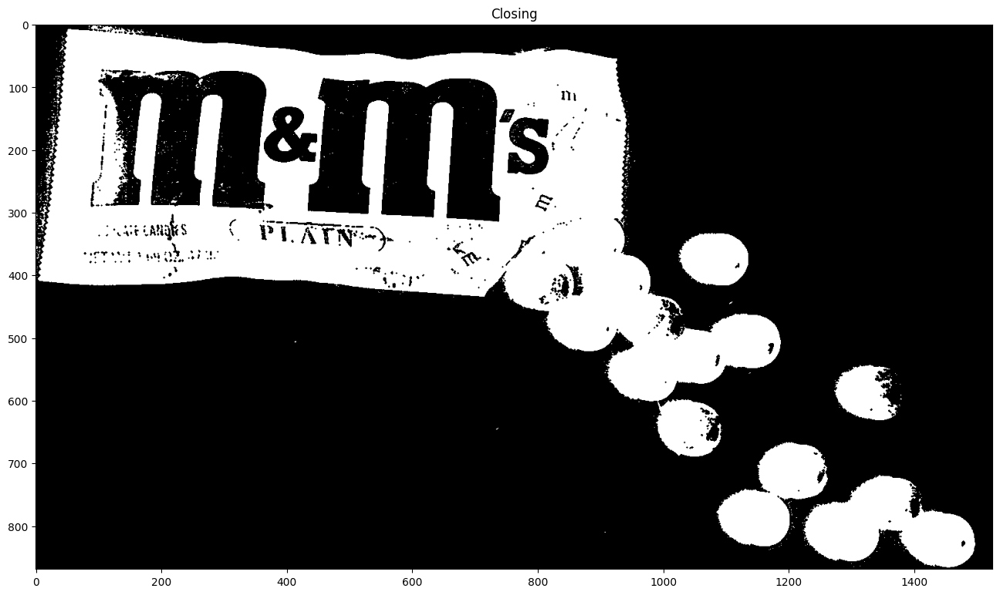

In [28]:
# Closing
kernal = np.uint8([[0,1,0],
                  [1,1,1],
                  [0,1,0]])
closing = cv2.morphologyEx(thresloding , cv2.MORPH_CLOSE , kernel=kernal)

plt.figure(figsize=(16,10))
plt.imshow(closing,cmap='gray')
plt.title('Closing')
plt.show()


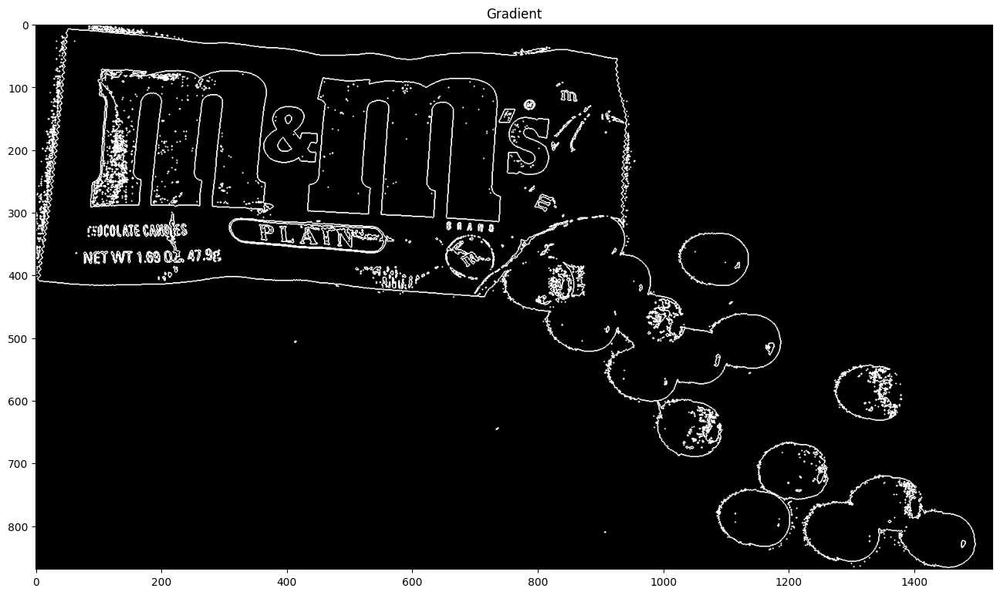

In [29]:
# Closing
kernal = np.uint8([[0,1,0],
                  [1,1,1],
                  [0,1,0]])
gradient = cv2.morphologyEx(thresloding , cv2.MORPH_GRADIENT , kernel=kernal)

plt.figure(figsize=(16,10))
plt.imshow(gradient,cmap='gray')
plt.title('Gradient')
plt.show()


# Edge Detection

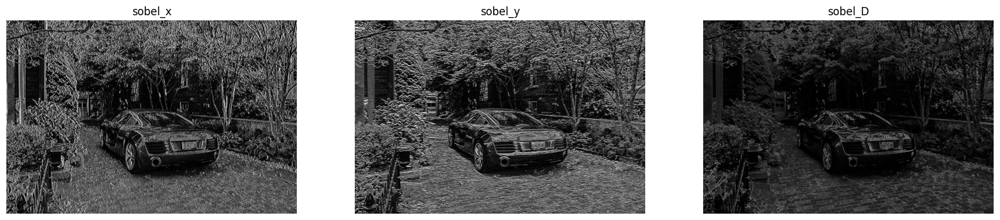

In [30]:
# 1. Sobel
import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('3.jpg' ,0)

sobel_x = cv2.Sobel(img,ddepth=-1,dx=1,dy=0,ksize=5)
sobel_y = cv2.Sobel(img,ddepth=-1,dx=0,dy=1,ksize=5)
sobel_d = cv2.Sobel(img,ddepth=-1,dx=1,dy=1,ksize=5)

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the first image
plt.subplot(1, 3, 1)
plt.imshow(sobel_x,cmap='gray')
plt.axis('off')
plt.title('sobel_x')

# Display the second image
plt.subplot(1, 3, 2)
plt.imshow(sobel_y,cmap='gray')
plt.axis('off')
plt.title('sobel_y')

# Display the second image
plt.subplot(1, 3, 3)
plt.imshow(sobel_d,cmap='gray')
plt.axis('off')
plt.title('sobel_D')

plt.show()

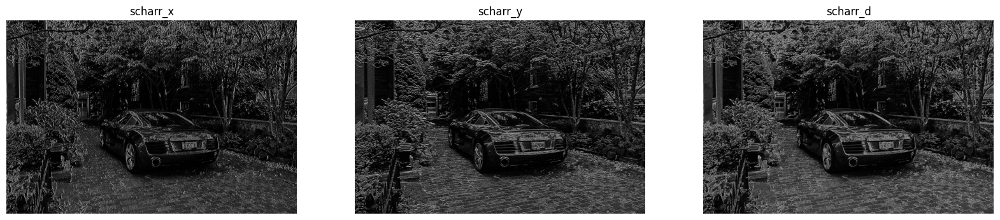

In [31]:
# 2. Scharr
import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('3.jpg' ,0)

scharr_x = cv2.Scharr(img, ddepth=-1, dx=1, dy=0)
scharr_y = cv2.Scharr(img, ddepth=-1, dx=0, dy=1)

# Convert to float32 for magnitude computation
scharr_x = np.float32(scharr_x)
scharr_y = np.float32(scharr_y)

scharr_d = cv2.magnitude(scharr_x, scharr_y)  # Combine gradient magnitudes

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the first image
plt.subplot(1, 3, 1)
plt.imshow(scharr_x, cmap='gray')
plt.axis('off')
plt.title('scharr_x')

# Display the second image
plt.subplot(1, 3, 2)
plt.imshow(scharr_y, cmap='gray')
plt.axis('off')
plt.title('scharr_y')

# Display the combined gradient image
plt.subplot(1, 3, 3)
plt.imshow(scharr_d, cmap='gray')
plt.axis('off')
plt.title('scharr_d')

plt.show()

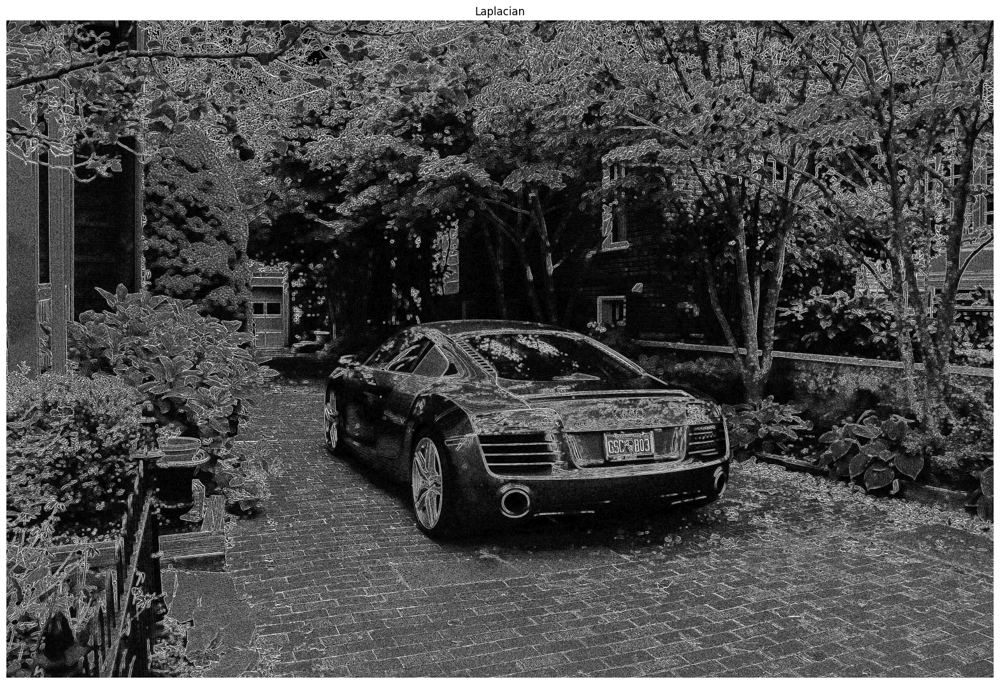

In [32]:
# 3. Laplacian

import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('3.jpg' ,0)

laplacian = cv2.Laplacian(img, ddepth=-1, ksize=5)

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the Laplacian image
plt.imshow(laplacian, cmap='gray')
plt.axis('off')
plt.title('Laplacian')

plt.show()


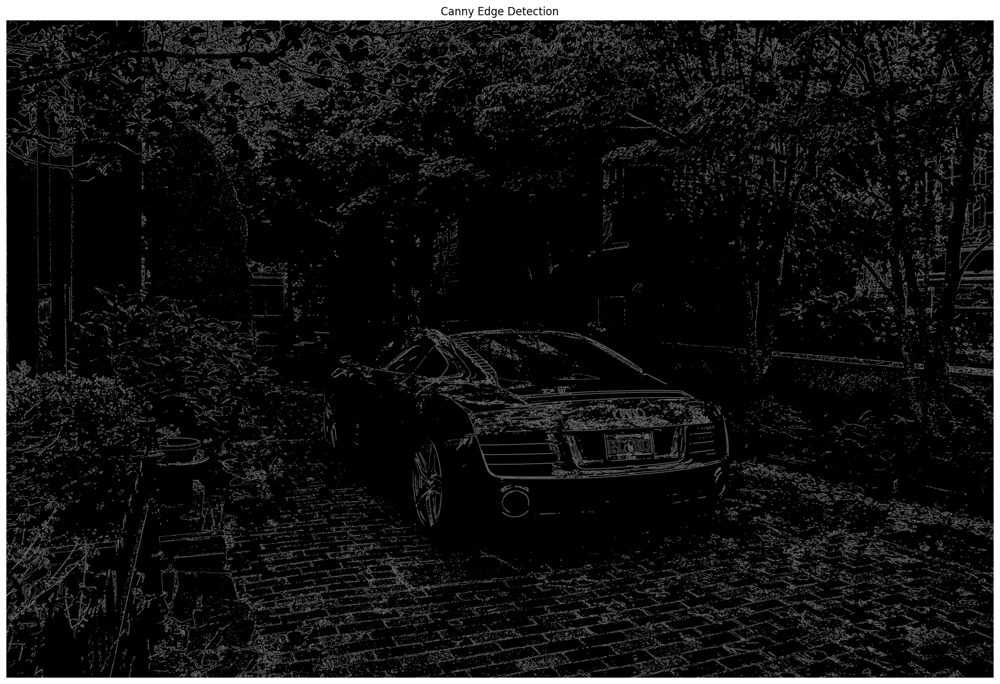

In [33]:
# 4. Canny Edge Detection

import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('3.jpg', 0)

# Using Canny edge detector. You can adjust the threshold values.
canny = cv2.Canny(img, 150, 200)

# Create a new figure
plt.figure(figsize=(20, 15))

# Display the Canny edge-detected image
plt.imshow(canny, cmap='gray')
plt.axis('off')
plt.title('Canny Edge Detection')

plt.show()


# Images Features

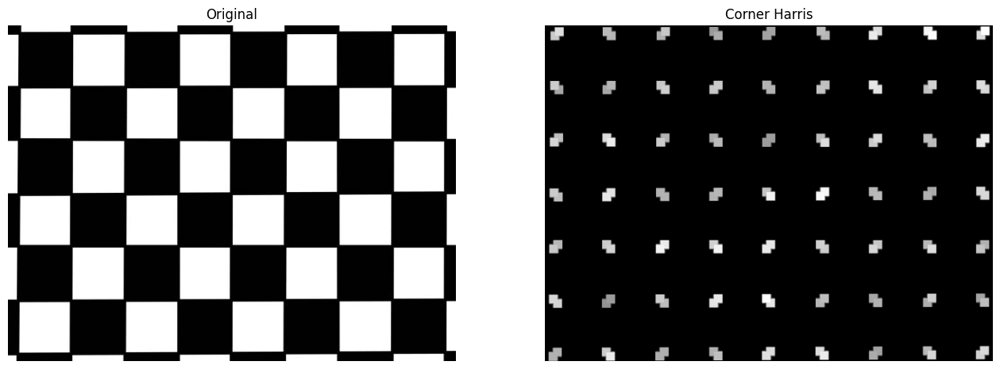

In [38]:
# 1. Corner Harris
import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('4.jpg', 0)

corners = cv2.cornerHarris(img,blockSize=4,ksize=3,k=0.04)
corners = cv2.dilate(corners,None,iterations=5)
# Create a new figure
plt.figure(figsize=(16, 10))

# Display the first image
plt.subplot(1, 2, 1)
plt.imshow(img,'gray')
plt.axis('off')
plt.title('Original')

# Display the second image
plt.subplot(1, 2, 2)
plt.imshow(corners,'gray')
plt.axis('off')
plt.title('Corner Harris')

plt.show()

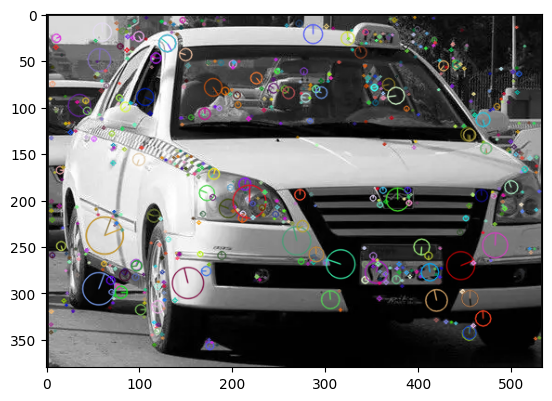

In [43]:
# 2. Sift Approach
import cv2 
import numpy as np
import matplotlib.pyplot as plt

img = cv2.imread('6.png')
gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

sift = cv2.SIFT_create(edgeThreshold=5)  
kp = sift.detect(gray, None)
img = cv2.drawKeypoints(gray, kp, img, flags=cv2.DRAW_MATCHES_FLAGS_DRAW_RICH_KEYPOINTS)
plt.imshow(img)
plt.show()

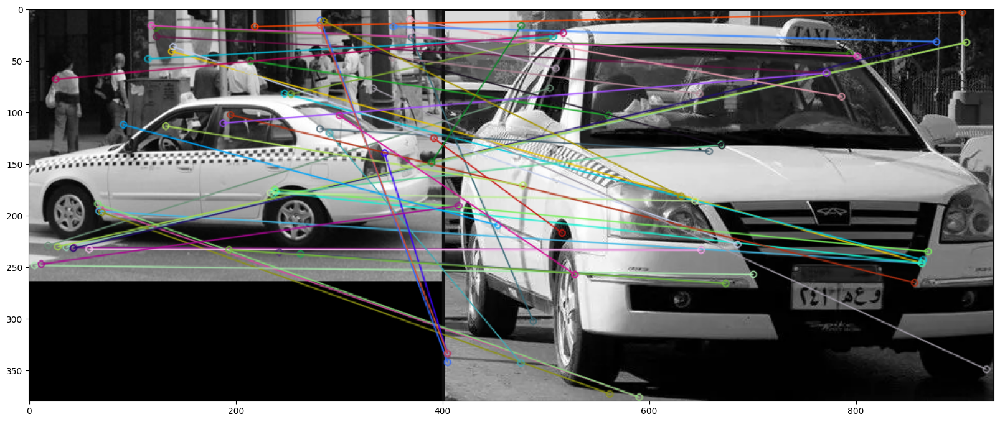

In [46]:
img1 = cv2.imread('5.jpg', 0)
img2 = cv2.imread('6.png', 0)

sift = cv2.SIFT_create()

# Using detectAndCompute to find keypoints and descriptors
kp1, des1 = sift.detectAndCompute(img1, None)
kp2, des2 = sift.detectAndCompute(img2, None)

bf = cv2.BFMatcher()
matches = bf.match(des1, des2)
matches = sorted(matches, key=lambda x: x.distance)

img3 = cv2.drawMatches(img1, kp1, img2, kp2, matches[:50], None, flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
plt.figure(figsize=(20,10))
plt.imshow(img3)
plt.show()